In [1]:
from icrawler.builtin import GoogleImageCrawler
from pathlib import Path

import PIL.Image as Image
from hashlib import sha256
import requests
from pyquery import PyQuery as pq

import pyparsing as pp
from pyparsing import common as ppc
import pandas as pd
from lxml import etree

import numpy as np
from gensim.test.utils import common_texts
from gensim.models import Word2Vec
import gensim.downloader
import random


from nltk import word_tokenize
from yarl import URL

In [153]:
temp_dir = Path("temp")
temp_dir.mkdir(exist_ok=True)


In [386]:
def get_image(description: str) -> Image.Image:
    """Get an image from Google Images that is relevant to the given description."""

    temp = temp_dir / sha256(description.encode("utf-8")).hexdigest()
    google_crawler = GoogleImageCrawler(
        feeder_threads=1,
        parser_threads=1,
        downloader_threads=1,
        storage={"root_dir": temp},
    )
    google_crawler.crawl(keyword=description, max_num=4)

    return Image.open(random.choice(list(temp.iterdir())))

2022-10-21 17:43:17,343 - INFO - icrawler.crawler - start crawling...
2022-10-21 17:43:17,346 - INFO - icrawler.crawler - starting 1 feeder threads...
2022-10-21 17:43:17,348 - INFO - feeder - thread feeder-001 exit
2022-10-21 17:43:17,362 - INFO - icrawler.crawler - starting 1 parser threads...
2022-10-21 17:43:17,364 - INFO - icrawler.crawler - starting 1 downloader threads...
2022-10-21 17:43:18,285 - INFO - parser - parsing result page https://www.google.com/search?q=Bicycle+Racing&ijn=0&start=0&tbs=&tbm=isch
2022-10-21 17:43:18,333 - INFO - downloader - skip downloading file 000001.jpg
2022-10-21 17:43:18,704 - INFO - downloader - image #2	https://s3.amazonaws.com/usac-craft-uploads-production/assets/Road-Header_200611_104055.jpg
2022-10-21 17:43:20,580 - INFO - downloader - image #3	https://upload.wikimedia.org/wikipedia/commons/d/d8/Giro_d%27Italia_2021%2C_Stage_15.jpg
2022-10-21 17:43:21,013 - INFO - downloader - image #4	https://havefunbiking.com/wp-content/uploads/2016/06/HFB

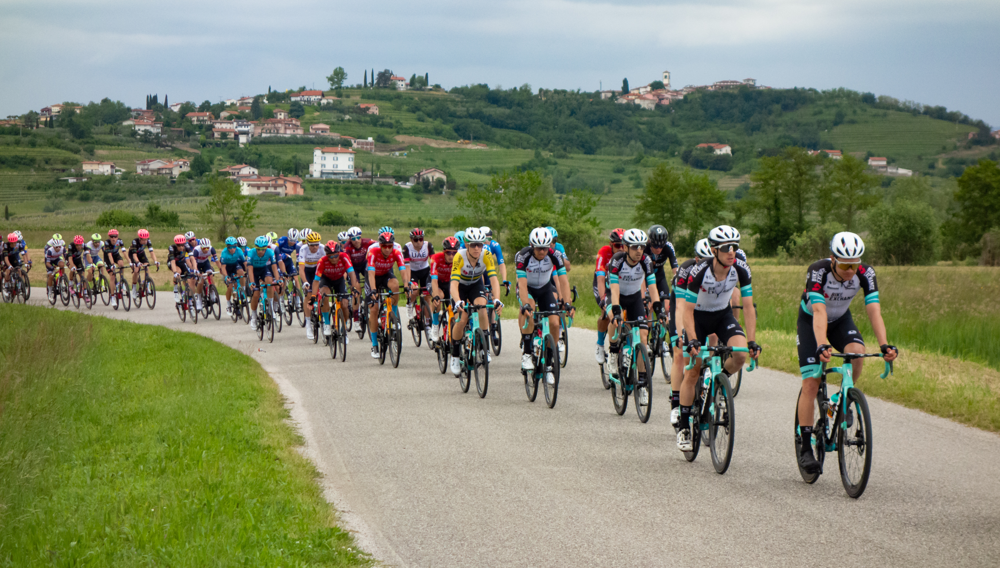

In [387]:
get_image("Bicycle Racing")


In [156]:
def get_translate(description: str, target_lang: str = "zh-CN") -> str:
    url = "https://translate.googleapis.com/translate_a/single"
    params = {
        "client": "gtx",
        "sl": "en",
        "tl": target_lang,
        "dt": "t",
        "q": description,
    }
    response = requests.get(url, params=params)
    return response.json()[0][0][0]



In [370]:
from collections.abc import Callable

pp.ParserElement.enable_packrat()


def _make_parser() -> Callable[[str], dict[str, str]]:
    import functools
    from operator import or_
    import re

    chrs = "()[]{}<>«»"
    nested = functools.reduce(
        or_,
        [
            pp.nested_expr(opener, closer)
            for opener, closer in zip(chrs[::2], chrs[1::2])
        ],
    )

    sentence = pp.original_text_for(
        pp.SkipTo(pp.Char(".!?") + pp.Char("”’'\"")[...], include=True, ignore=nested)
    ).add_parse_action(lambda t: re.sub(r"\s+", " ", t[0].strip()))

    meaning = pp.Group(
        pp.Combine(ppc.integer + ".")
        + pp.QuotedString(quote_char="(", end_quote_char=")")("meaning")
        + pp.LineEnd()
        + pp.Group(
            pp.Combine(pp.Char(pp.alphas.lower()) + ".").suppress()
            + pp.SkipTo(pp.LineEnd(), include=True)("meaning")
            + pp.Group(sentence("spanish") + sentence("english"))("example")
        )[(1,)]("case")
    )[(1,)]("meaning")

    def _parse(str):
        return meaning.parseString(str).as_dict()

    return _parse

parse = _make_parser()

In [326]:
PLACE_HOLDER = object()


def find_dict(data: list[dict], key, val, default=PLACE_HOLDER):
    for dct in data:
        if isinstance(dct, dict) and dct.get(key, PLACE_HOLDER) == val:
            return dct
        elif (attr_dct := getattr(dct, "__dict__", None)) is not None:
            if attr_dct.get(key, PLACE_HOLDER) == val:
                return dct
        else:
            raise ValueError(f"Unable to search for {dct!r}")
    if default is not PLACE_HOLDER:
        return default
    raise ValueError(f"Unable to find {key!r}: {val!r}")


In [6]:
model = gensim.downloader.load("glove-twitter-25")


In [314]:
def cosine_similarity(a, b):
    return a @ b / (np.linalg.norm(a) * np.linalg.norm(b))


def pair_wise_cosine_similarity(a, b):
    return np.array(
        [[cosine_similarity(a[i], b[j]) for j in range(len(b))] for i in range(len(a))]
    )


def similar(sentence_a, sentence_b, pooling: str = "mean"):
    word_sentence_a, word_sentence_b = [
        [word for word in word_tokenize(sentence.lower()) if word in model]
        for sentence in [sentence_a, sentence_b]
    ]
    if len(word_sentence_a) == 0 or len(word_sentence_b) == 0:
        return 0

    word_sentence_a, word_sentence_b = [
        np.array([model[word] for word in sentence])
        for sentence in [word_sentence_a, word_sentence_b]
    ]

    similarity = pair_wise_cosine_similarity(word_sentence_a, word_sentence_b)

    if pooling == "mean":
        return similarity.mean()
    elif pooling == "max":
        return similarity.max()
    elif pooling == "min":
        return similarity.min()
    else:
        raise ValueError(f"Unknown pooling method: {pooling!r}")


In [378]:
def get_example_sentence(word: str, definition: str):
    try:
        resp = requests.get(f"https://www.spanishdict.com/translate/{word}")
        resp.raise_for_status()
    except requests.exceptions.HTTPError as e:
        raise ValueError(f"Unable to get example sentence for {word!r}") from e

    html = etree.HTML(resp.text)
    text = ""

    text = ""

    for e in html.xpath('//*[@id="dictionary-neodict-es"]/div/div/div'):
        temp = "\n".join(pq(e).text() for e in e.xpath(f"./div/div"))
        if temp.startswith("A"):
            text += "\n"
            continue
        text += temp

    meanings = parse(text)["meaning"]

    top_meanings = [
        item["meaning"] + " " + " ".join(case["meaning"] for case in item["case"])
        for item in meanings
    ]

    similarities = [similar(definition, meaning, "max") for meaning in top_meanings]
    idx = np.argmax(similarities)
    sub_meanings = meanings[idx]["case"]
    examples = [case["example"] for case in sub_meanings]

    similarities = [similar(definition, sentence["english"], "max") for sentence in examples]
    idx = np.argmax(similarities)
    sentence = examples[idx]["spanish"]
    return sentence



In [393]:
from functools import cached_property

class Vocab:
    def __init__(self, word: str, definition: str):
        self.word = word
        self.definition = definition
    
    @cached_property
    def example(self):
        return get_example_sentence(self.word, self.definition)
    
    @cached_property
    def image(self):
        return get_image(self.word)



In [57]:
ua = 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.114 Safari/537.36'

def get(url, *args, **kwargs):
    return requests.get(url, headers={"User-Agent": ua}, *args, **kwargs)



In [66]:
from typing import Literal
import json
import io

flaticon_url = URL("https://www.flaticon.com/search")



def get_icon(
    word: str,
    color: Literal["black", "gradient", "color"] = "color",
    shape: Literal["all", "hand-drawn", "lineal-color", "fill", "outline"] = "fill",
) -> Image.Image:

    html = etree.HTML(
        get(
            "https://www.flaticon.com/search",
            params={
                "word": word,
                "type": "icon",
                "license": "",
                "color": color,
                "shape": shape,
            },
        ).text
    )
    icon_page_url = random.choice(html.xpath('//a[contains(@href, "free-icon")]/@href'))
    icon_page = etree.HTML(get(icon_page_url).text)
    icon_url = json.loads(
        icon_page.xpath(
            '//script[@type="application/ld+json"][contains(text(), "cdn-icons")]/text()'
        )[0]
    )["contentUrl"]
    return Image.open(io.BytesIO(get(icon_url).content))

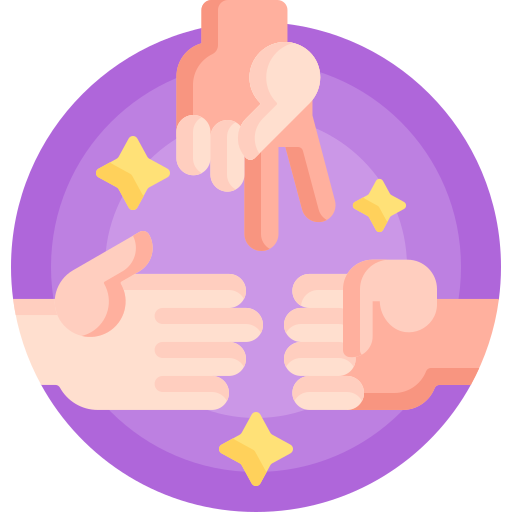

In [67]:
get_icon("paper")